# Kernel Density Estimation

We implement KDE class from scratch for n dimensional data. The class has methods to fit the data, select bandwidth using LOOCV, evaluate density at a point and visualize the density function for 1D and 2D data.

In [1]:
# importing libraries
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()
import numpy as np
from sklearn.model_selection import train_test_split

## Implementation of KDE

The KDE class supports 3 kinds of kernels - Gaussian, Triangular and Box. 

To select your own bandwidth, use the fit method with bandwidth as a parameter. To select bandwidth using LOOCV, fit using only data. The bandwidth can be accessed using the bandwidth attribute.

Alternatively select_bandwidth method can be used. If bandwidth is not specified, it uses LOOCV to select bandwidth. If bandwidth is specified, it sets the bandwidth to the specified value.

In [2]:
class KernelDensityEstimator:
    def __init__(self, kernel='box'):
        self.kernel_type = kernel
        if self.kernel_type not in ['gaussian', 'triangular', 'box']:
            raise ValueError('Kernel type not supported')
        self.bandwidth = None
        self.data = None
        
    def kernel_function(self, x):
        if self.kernel_type == 'gaussian':
            return np.exp(-0.5 * np.linalg.norm(x)) / (np.sqrt(2 * np.pi)**len(x))
        elif self.kernel_type == 'triangular':
            return np.prod(np.maximum(1 - np.abs(x), 0))
        elif self.kernel_type == 'box':
            if np.all(np.abs(x) <= 0.5):
                return 1.0
            else:
                return 0.0
        
    def log_likelihood(self, data, bandwidth=None):
        if len(data.shape) == 1:
            data = data.reshape(-1, 1)
        n, d = data.shape
        log_likelihood = 0.0

        if bandwidth is None:
            if self.bandwidth is None:
                raise ValueError('Bandwidth not specified')
            else:
                bandwidth = self.bandwidth

        # For each data point, add the log of the sum of the prob density of rest of the points
        for i in range(n):
            log_likelihood += np.log(np.sum([self.kernel_function((data[i] - data[j]) / bandwidth)
                                             for j in range(n) if j != i]) / ((n-1)*bandwidth**d))

        return log_likelihood / n
    
    '''Selects bandwidth using LOOCV if bandwidth is not specified, else sets the bandwidth to the specified value'''
    def select_bandwidth(self, bandwidth=None):
        if bandwidth is not None:
            self.bandwidth = bandwidth
            return self.bandwidth

        if self.data is None:
            raise ValueError('Data not specified')

        # LOOCV to select bandwidth using self.negative_log_likelihood
        bandwidths = np.linspace(0.001, 0.1, 25)
        log_likelihoods = []
        for bandwidth in bandwidths:
            log_likelihoods.append(self.log_likelihood(self.data, bandwidth))
        
        self.bandwidth = bandwidths[np.argmax(log_likelihoods)]
        return self.bandwidth

    def fit(self, data, bandwidth=None):
        if len(data.shape) == 1:
            self.data = data.reshape(-1, 1)
        else:
            self.data = data

        if bandwidth is not None:
            self.bandwidth = bandwidth
        else:
            self.bandwidth = self.select_bandwidth()

    def evaluate_density(self, x):
        if self.data is None or self.bandwidth is None:
            raise ValueError('Data not fitted')

        x = np.array(x)
        # Density is defined as average of kernel function values at each data point divided by bandwidth**d
        n, d = self.data.shape
        density = 0.0
        for i in range(n):
            density += self.kernel_function((x - self.data[i]) / self.bandwidth)
        density /= (n * self.bandwidth**d)
        return density

    '''Visualizes the density function for 1D and 2D data.'''
    def visualize(self):
        d = self.data.shape[1]

        xmin = np.min(self.data, axis=0)
        xmax = np.max(self.data, axis=0)
        plt.figure(figsize=(10, 10))
        if d == 1:
            x = np.linspace(xmin, xmax, 100)
            y = [self.evaluate_density([x_i]) for x_i in x]
            plt.plot(x, y)
            plt.scatter(self.data, np.zeros_like(self.data), alpha=0.2)
            plt.show()
        elif d == 2:
            x = np.linspace(xmin[0], xmax[0], 100)
            y = np.linspace(xmin[1], xmax[1], 100)
            X, Y = np.meshgrid(x, y)
            Z = np.array([[self.evaluate_density([x_i, y_i]) for x_i in x] for y_i in y])
            plt.contour(X, Y, Z)
            plt.show()
        else:
            raise ValueError('Dimensionality not supported')

## KDE for Bounding Box connections in a document image

In [111]:
import cv2
import pandas as pd

### Scripts related to processing of data

In [115]:
def visualize_bboxes(img):
    img_2 = img.copy()
    for index, rows in df.iterrows():
        top_left = (int(rows['Top-Left'].split(',')[0][1:]), int(rows['Top-Left'].split(',')[1][:-1]))
        bottom_right = (int(rows['Bottom-Right'].split(',')[0][1:]), int(rows['Bottom-Right'].split(',')[1][:-1]))
        cv2.rectangle(img_2, top_left, bottom_right, (255, 0, 0), 2)

    # Increase the size of the image displayed
    plt.rcParams["figure.figsize"] = (15, 15)
    plt.imshow(img_2)


def make_connections(image, euclidean):
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    image_with_boxes = image_rgb.copy()

    for index, row in euclidean.iterrows():
        left = int(row['Left'][0])
        right = int(row['Right'][0])
        top = int(row['Top'][1])
        bottom = int(row['Bottom'][1])
        box_id = int(row['Id'])

        width = right - left
        height = bottom - top

        top_left = (left, top)
        bottom_right = (right, bottom)

        cv2.rectangle(image_with_boxes, top_left, bottom_right, (255, 0, 0), 2)

        label_position = (left, top - 10)
        cv2.putText(image_with_boxes, str(box_id), label_position, cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 1)

        top_adjacent_id = int(row['Top_Box'][1])
        bottom_adjacent_id = int(row['Bottom_Box'][1])
        left_adjacent_id = int(row['Left_Box'][1])
        right_adjacent_id = int(row['Right_Box'][1])

        if top_adjacent_id != 0:
            top_adjacent_row = euclidean[euclidean['Id'] == top_adjacent_id].iloc[0]
            top_adjacent_center = int(top_adjacent_row['Bottom'][0]), int(top_adjacent_row['Bottom'][1])
            cv2.line(image_with_boxes, (int(left) + width // 2, int(top)), top_adjacent_center, (0, 255, 0), 2)

        if bottom_adjacent_id != 0:
            bottom_adjacent_row = euclidean[euclidean['Id'] == bottom_adjacent_id].iloc[0]
            bottom_adjacent_center = int(bottom_adjacent_row['Top'][0]), int(bottom_adjacent_row['Top'][1])
            cv2.line(image_with_boxes, (int(left) + width // 2, int(bottom)),
                     (int(bottom_adjacent_center[0]), int(bottom_adjacent_center[1])), (0, 255, 0), 2)

        if left_adjacent_id != 0:
            left_adjacent_row = euclidean[euclidean['Id'] == left_adjacent_id].iloc[0]
            left_adjacent_center = int(left_adjacent_row['Right'][0]), int(left_adjacent_row['Right'][1])
            cv2.line(image_with_boxes, (int(left), int(top) + height // 2),
                     (int(left_adjacent_center[0]), int(left_adjacent_center[1])), (0, 255, 0), 2)

        if right_adjacent_id != 0:
            right_adjacent_row = euclidean[euclidean['Id'] == right_adjacent_id].iloc[0]
            right_adjacent_center = int(right_adjacent_row['Left'][0]), int(right_adjacent_row['Left'][1])
            cv2.line(image_with_boxes, (int(right), int(top) + height // 2),
                     (int(right_adjacent_center[0]), int(right_adjacent_center[1])), (0, 255, 0), 2)

    return image_with_boxes

## Scripts to add connections

The functions add_columns and add_connections are used to add columns to the dataframe and add connections to the dataframe respectively.

This is used for plotting the bounding boxes and connections.

In [116]:
def add_columns(data):
    data_copy = data.copy()
    data_copy['Top-Left'] = data_copy['Top-Left'].apply(lambda x: [int(t) for t in x[1:-1].split(', ')])
    data_copy['Bottom-Right'] = data_copy['Bottom-Right'].apply(lambda x: [int(t) for t in x[1:-1].split(', ')])

    x1 = data_copy['Top-Left'].apply(lambda x: x[0])
    x2 = data_copy['Bottom-Right'].apply(lambda x: x[0])
    y1 = data_copy['Bottom-Right'].apply(lambda x: x[1])
    y2 = data_copy['Top-Left'].apply(lambda x: x[1])

    data_copy['Top-x'] = (x1 + x2) / 2.0
    data_copy['Top-y'] = y2
    data_copy['Bottom-x'] = (x1 + x2) / 2.0
    data_copy['Bottom-y'] = y1
    data_copy['Left-x'] = x1
    data_copy['Left-y'] = (y1 + y2) / 2.0
    data_copy['Right-x'] = x2
    data_copy['Right-y'] = (y1 + y2) / 2.0
    
    # Edge center columns
    data_copy['Top'] = [[row['Top-x'], row['Top-y']] for index, row in data_copy.iterrows()]
    data_copy['Bottom'] = [[row['Bottom-x'], row['Bottom-y']] for index, row in data_copy.iterrows()]
    data_copy['Left'] = [[row['Left-x'], row['Left-y']] for index, row in data_copy.iterrows()]
    data_copy['Right'] = [[row['Right-x'], row['Right-y']] for index, row in data_copy.iterrows()]
    data_copy.drop(columns=['Top-x', 'Top-y', 'Bottom-x', 'Bottom-y', 'Left-x', 'Left-y', 'Right-x', 'Right-y'], inplace=True)
    return data_copy

In [117]:
def custom_distance(row1, row2):
    top1, bottom1, left1, right1 = row1['Top'], row1['Bottom'], row1['Left'], row1['Right']
    top2, bottom2, left2, right2 = row2['Top'], row2['Bottom'], row2['Left'], row2['Right']

    euclidean = lambda x1, x2: np.sqrt((x1[0] - x2[0]) ** 2 + (x1[1] - x2[1]) ** 2)
    minDist = np.argmin([euclidean(top1, bottom2), euclidean(bottom1, top2), euclidean(left1, right2), euclidean(right1, left2)])
    if minDist == 0:
        return euclidean(top1, bottom2), 'Top'
    elif minDist == 1:
        return euclidean(bottom1, top2), 'Bottom'
    elif minDist == 2:
        return euclidean(left1, right2), 'Left'
    else:
        return euclidean(right1, left2), 'Right'

In [118]:
def add_connections(data, threshold=(50,80)):
    # Add connection columns to dataframe
    data_copy = data.copy()
    
    data_copy['Top_Box'] = [[-1, 0] for _ in range(len(data_copy))]
    data_copy['Bottom_Box'] = [[-1, 0] for _ in range(len(data_copy))]
    data_copy['Left_Box'] = [[-1, 0] for _ in range(len(data_copy))]
    data_copy['Right_Box'] = [[-1, 0] for _ in range(len(data_copy))]

    for i in range(len(data_copy)):
        row1 = data_copy.iloc[i]
        for j in range(len(data_copy)):
            if i == j:
                continue
            row2 = data_copy.iloc[j]
            # Find the closest type of distance, and update column if distance less than threshold and current nearest
            dist, direction = custom_distance(row1, row2)
            th = threshold[0] if direction in ['Top', 'Bottom'] else threshold[1]
            box_name = direction + '_Box'
            if dist < th and (row1[box_name][0] == -1 or row1[box_name][0] > dist):
                row1[box_name][0] = dist
                row1[box_name][1] = row2['Id']

    return data_copy

## Finding thresholds for connections

We use KDE to find the thresholds for connections.

### The algorithm
1. Add columns to the dataframe
2. Add vertical and horizontal distance of closest bounding box to each bounding box in the dataframe.
3. Fit KDE on the vertical and horizontal distances, seperately. This is done after normalizing the distances.
4. Find the threshold by taking maximum distance with atleast 0.5 * max density. This heuristic is used to avoid outliers.
5. Visualize the probability density plots for the 2 distances.
6. Plot the bounding boxes and connections using the threshold.
 
In this process, bandwidth can be used as a hyperparameter.

In [119]:
def add_distances(data):
    data_copy = data.copy()
    data_copy['vertical'] = [9999 for _ in range(len(data_copy))]
    data_copy['horizontal'] = [9999 for _ in range(len(data_copy))]
    
    euclidean = lambda x, y: np.sqrt((x[0] - y[0])**2 + (x[1] - y[1])**2)
    
    for i in range(len(data_copy)):
        row1 = data_copy.iloc[i]
        vertical = row1['vertical']
        horizontal = row1['horizontal']
        for j in range(len(data_copy)):
            if i == j:
                continue
            row2 = data_copy.iloc[j]
            # Find closest vertical and horizontal distance
            vertical = min(vertical, euclidean(row1['Top'], row2['Bottom']))
            vertical = min(vertical, euclidean(row1['Bottom'], row2['Top']))
            data_copy.at[i, 'vertical'] = vertical
            
            horizontal = min(horizontal, euclidean(row1['Left'], row2['Right']))
            horizontal = min(horizontal, euclidean(row1['Right'], row2['Left']))
            data_copy.at[i, 'horizontal'] = horizontal
            
    return data_copy   

In [264]:
def normalize_and_fit(x, bandwidth=None):
        min_x, max_x = np.min(x), np.max(x)
        x = (x - min_x) / (max_x - min_x)
        kde = KernelDensityEstimator(kernel='gaussian')
        kde.fit(x, bandwidth=bandwidth)
        return kde, min_x, max_x

def get_threshold_from_kde(kde, min_x, max_x):
        # Finding threshold by taking maximum distance with atleast 0.5 * max density
        possible_= np.linspace(0, 0.5, 100)
        prob_density = [kde.evaluate_density([x_i]) for x_i in possible_]
        prob_density = np.array(prob_density)
        prob_density  = prob_density > 0.5*np.max(prob_density)

        # maximum index with prob_density > 0.5
        max_index = np.max(np.where(prob_density))
        threshold = possible_[max_index]*(max_x - min_x) + min_x
        return threshold

def get_threshold(df, bandwidth=None):
    x = df['vertical'].values.reshape(-1, 1)
    kde_v, min_x, max_x = normalize_and_fit(x, bandwidth=bandwidth)
    threshold_vertical = get_threshold_from_kde(kde_v, min_x, max_x)
    
    x = df['horizontal'].values.reshape(-1, 1)
    kde_h, min_x, max_x = normalize_and_fit(x, bandwidth=bandwidth)
    threshold_horizontal = get_threshold_from_kde(kde_h, min_x, max_x)
    
    # Display probability density plots in 2 subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))
    ax1.plot(np.linspace(0, 1, 100), [kde_v.evaluate_density([x_i]) for x_i in np.linspace(0, 1, 100)])
    ax1.set_title('Vertical distances')
    ax2.plot(np.linspace(0, 1, 100), [kde_h.evaluate_density([x_i]) for x_i in np.linspace(0, 1, 100)])
    ax2.set_title('Horizontal distances')
    
    return threshold_vertical, threshold_horizontal    

## Visualizing connections for different bandwidths

We try out different values for bandwidth: 0.001, 0.01, 0.1, 0.5 for each image and plot the density curves along with the output image.

### Image - 29

In [112]:
target = 29
document_img_path = 'SMAI - AQ2/images/{}.jpg'.format(target)
document_csv_path = 'SMAI - AQ2/CSV/TLBR_{}.csv'.format(target)
# Loading dataframe
df = pd.read_csv(document_csv_path)
df.head()

In [113]:
df_with_distances = add_distances(add_columns(df))

,Unnamed: 0,Top-Left,Bottom-Right,Id
0,0,"[338, 133]","[469, 185]",0
1,1,"[662, 126]","[795, 178]",1
2,2,"[822, 133]","[923, 185]",2
3,3,"[592, 250]","[694, 314]",3
4,4,"[735, 253]","[846, 308]",4


In [114]:
img = cv2.imread(document_img_path)

#### Bandwidth = 0.001

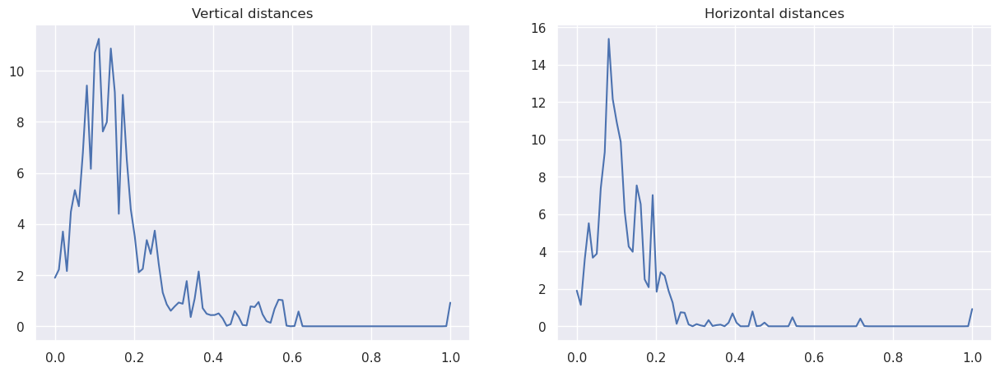

In [145]:
thr = get_threshold(df_with_distances, bandwidth=0.001)

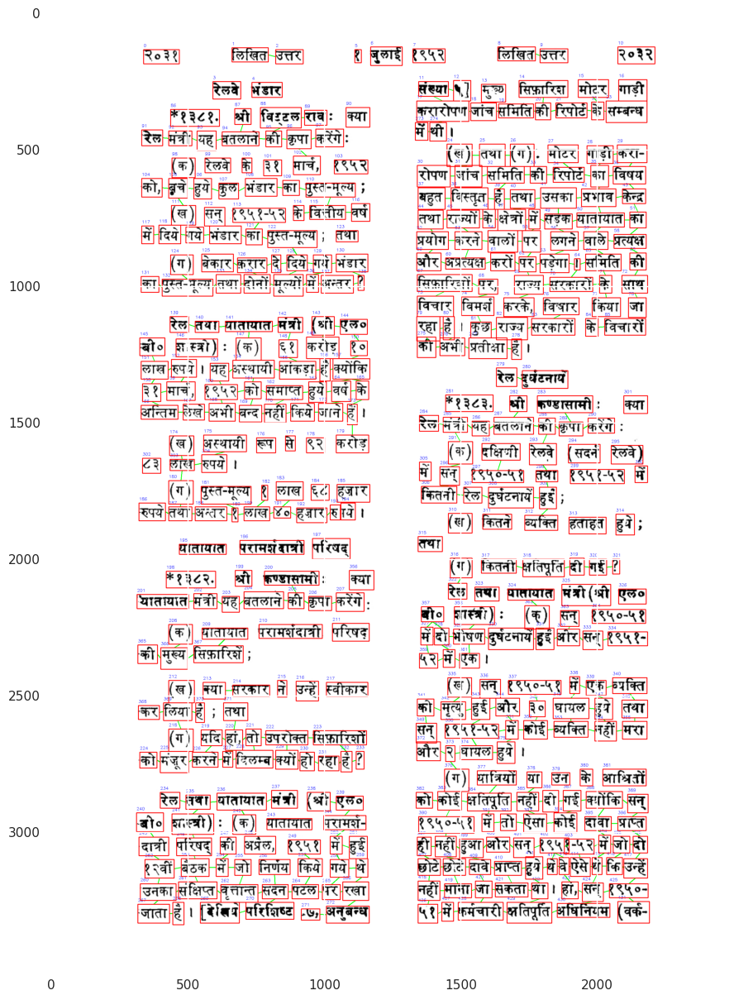

In [146]:
visualize_bboxes(make_connections(img, add_connections(df_with_distances, thr)))

#### Bandwidth = 0.01

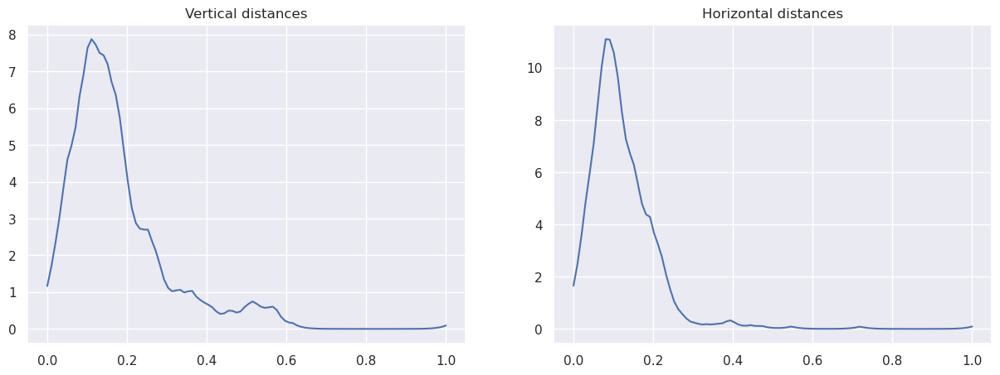

In [147]:
thr = get_threshold(df_with_distances, bandwidth=0.01)

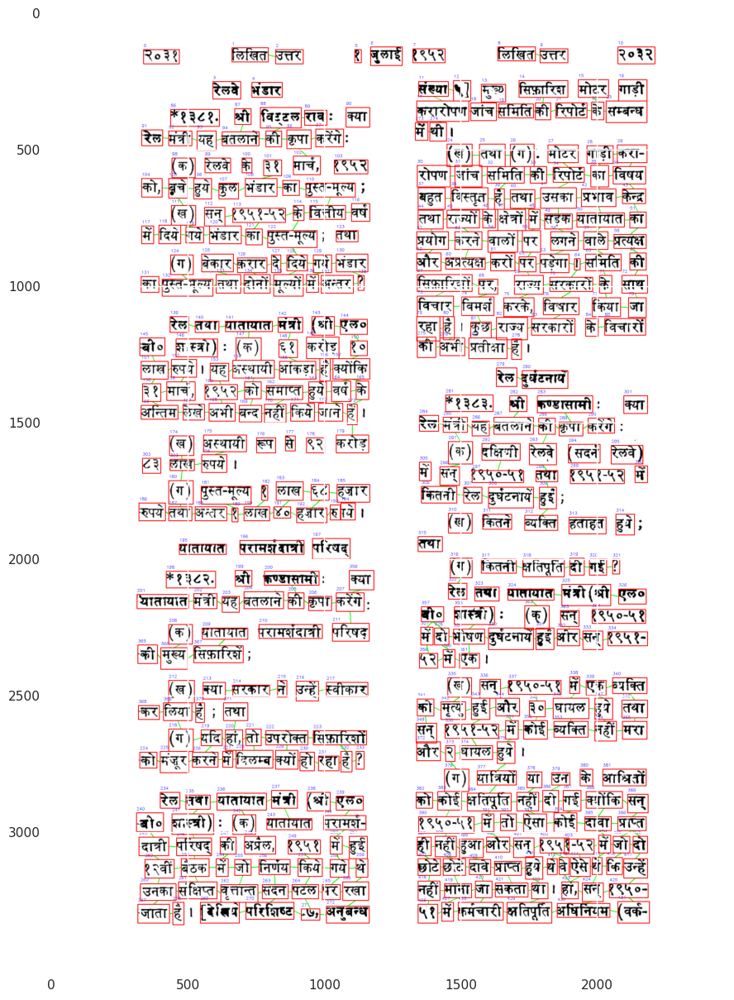

In [148]:
visualize_bboxes(make_connections(img, add_connections(df_with_distances, thr)))

#### Bandwidth = 0.1

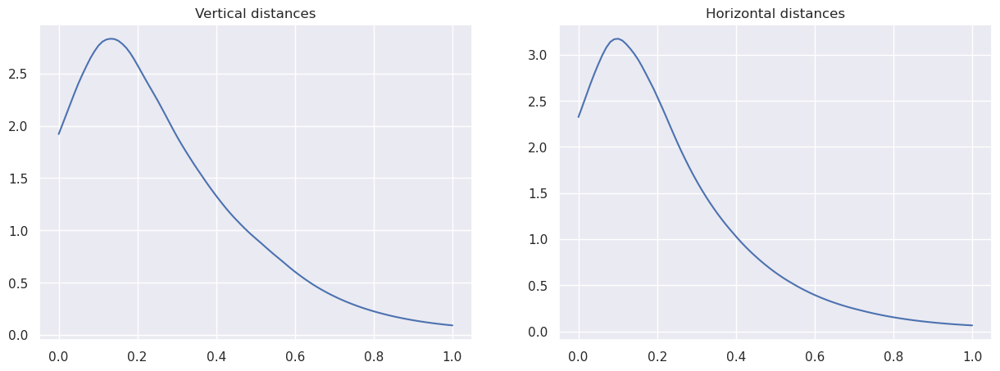

In [149]:
thr = get_threshold(df_with_distances, bandwidth=0.1)

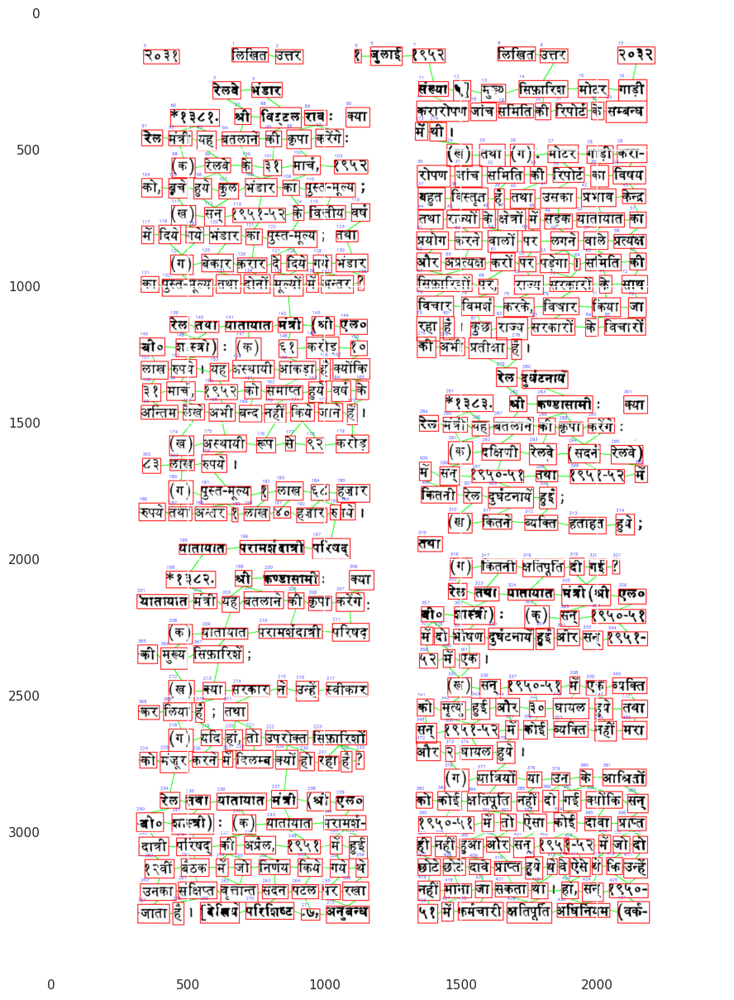

In [150]:
visualize_bboxes(make_connections(img, add_connections(df_with_distances, thr)))

#### Bandwidth = 0.5

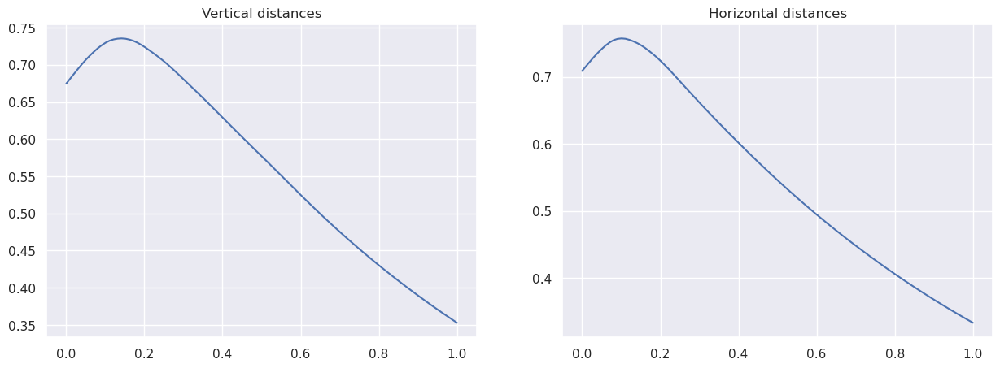

In [151]:
thr = get_threshold(df_with_distances, bandwidth=0.5)

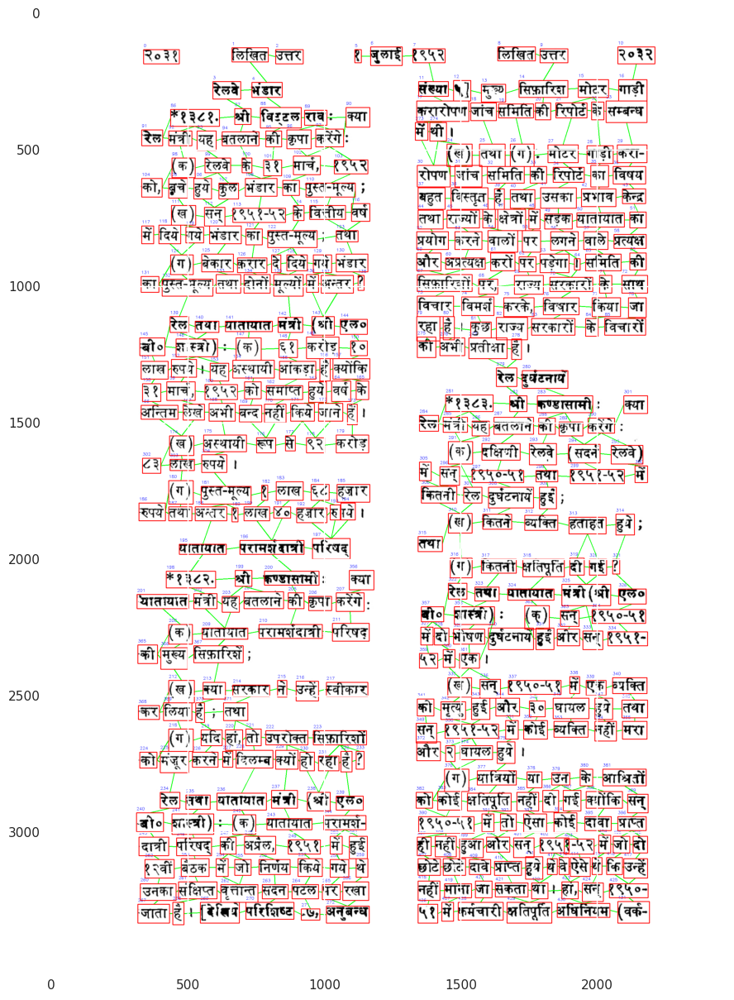

In [153]:
visualize_bboxes(make_connections(img, add_connections(df_with_distances, thr)))

### Image - 68

In [221]:
target = 68
document_img_path = 'SMAI - AQ2/images/{}.jpg'.format(target)
document_csv_path = 'SMAI - AQ2/CSV/TLBR_{}.csv'.format(target)
df = pd.read_csv(document_csv_path)
df.head()

,Unnamed: 0,Top-Left,Bottom-Right,Id
0,0,"[290, 85]","[435, 147]",0
1,1,"[563, 82]","[730, 147]",1
2,2,"[744, 92]","[940, 140]",2
3,3,"[1163, 92]","[1184, 147]",3
4,4,"[1218, 79]","[1344, 157]",4


In [222]:
img = cv2.imread(document_img_path)

In [223]:
df_with_distances = add_distances(add_columns(df))

/tmp/ipykernel_2264/2425874049.py:19: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '290.68883707497264' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  data_copy.at[i, 'vertical'] = vertical
/tmp/ipykernel_2264/2425874049.py:23: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '128.0087887607722' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  data_copy.at[i, 'horizontal'] = horizontal


#### Bandwidth = 0.001

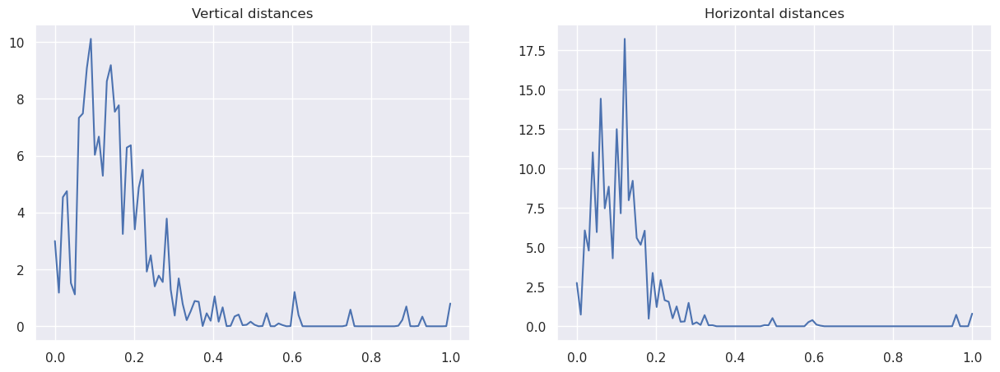

In [224]:
thr = get_threshold(df_with_distances, bandwidth=0.001)

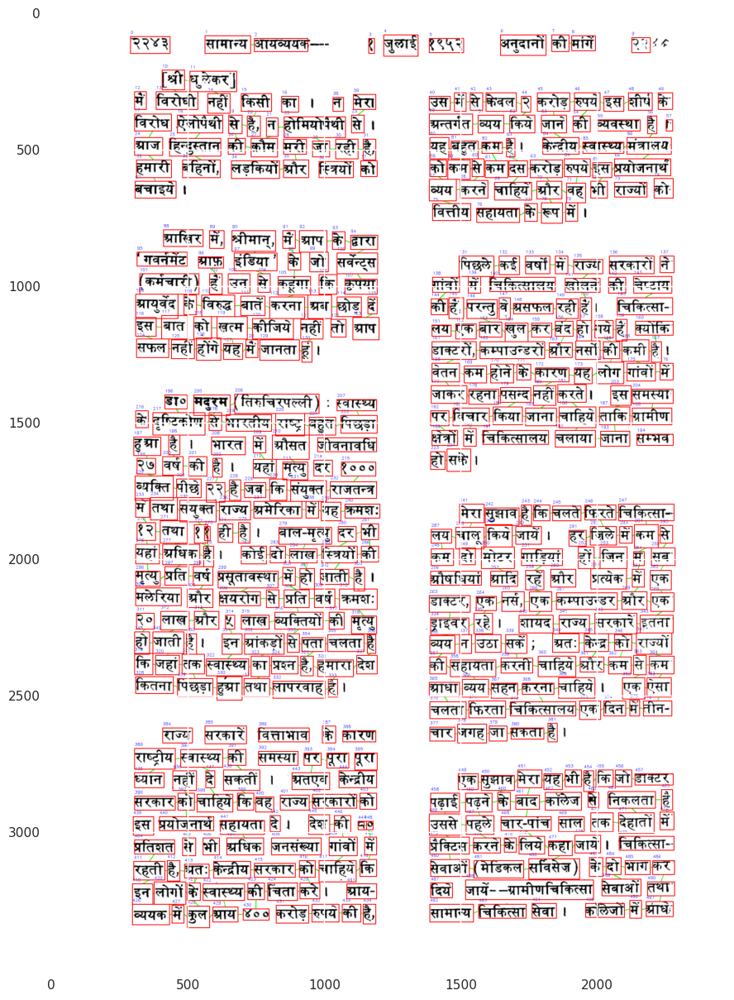

In [225]:
visualize_bboxes(make_connections(img, add_connections(df_with_distances, thr)))

#### Bandwidth = 0.01

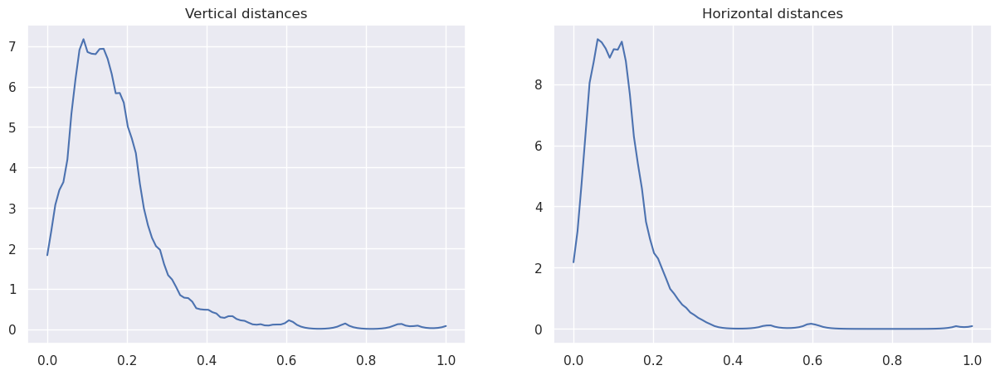

In [226]:
thr = get_threshold(df_with_distances, bandwidth=0.01)

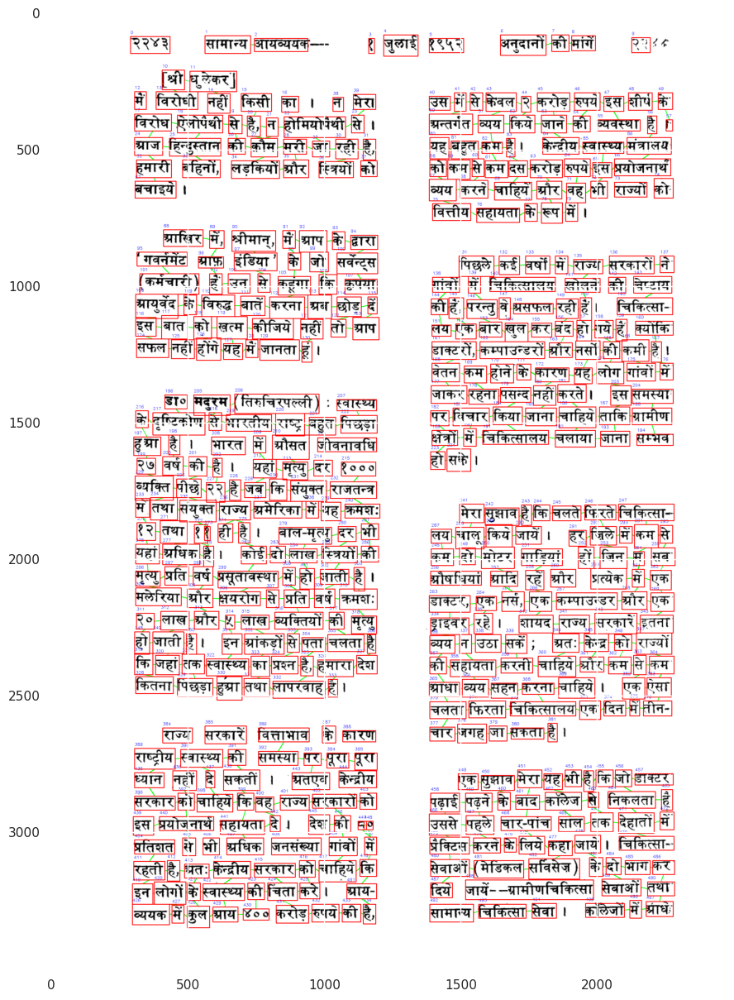

In [227]:
visualize_bboxes(make_connections(img, add_connections(df_with_distances, thr)))

#### Bandwidth = 0.1

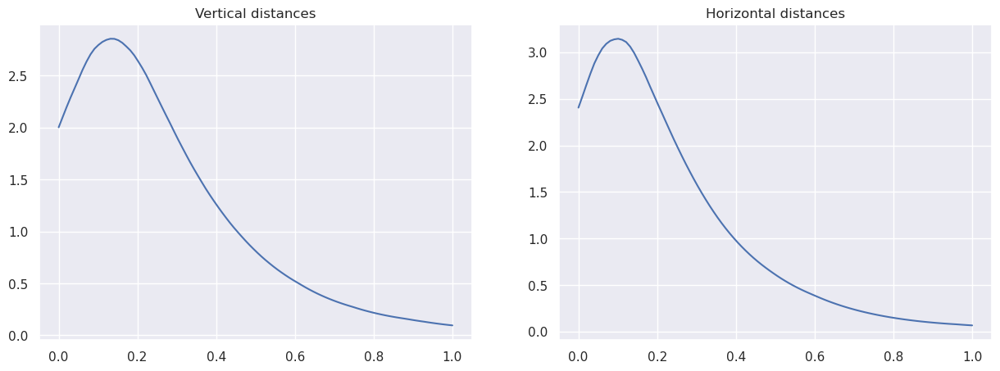

In [228]:
thr = get_threshold(df_with_distances, bandwidth=0.1)

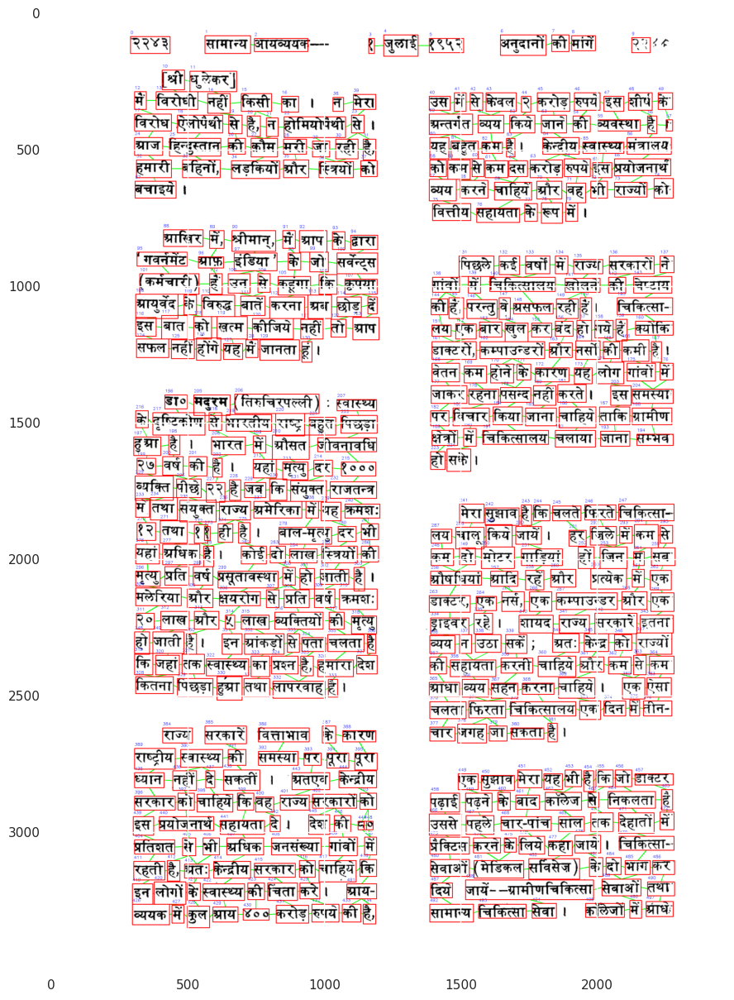

In [229]:
visualize_bboxes(make_connections(img, add_connections(df_with_distances, thr)))

#### Bandwidth = 0.5

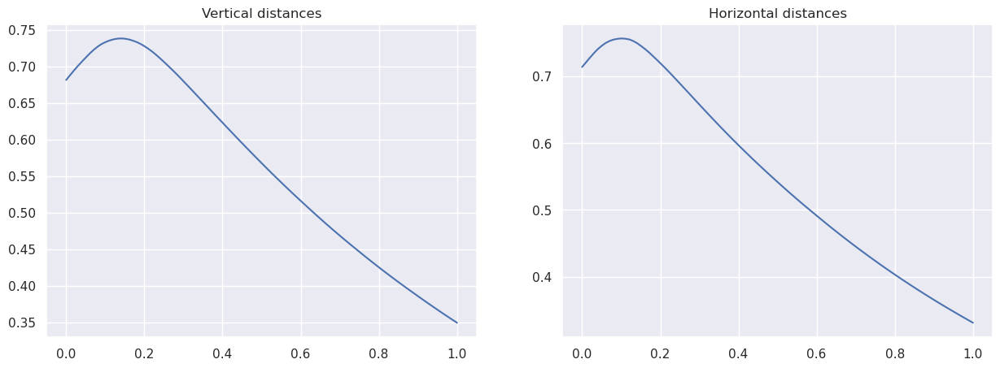

In [230]:
thr = get_threshold(df_with_distances, bandwidth=0.5)

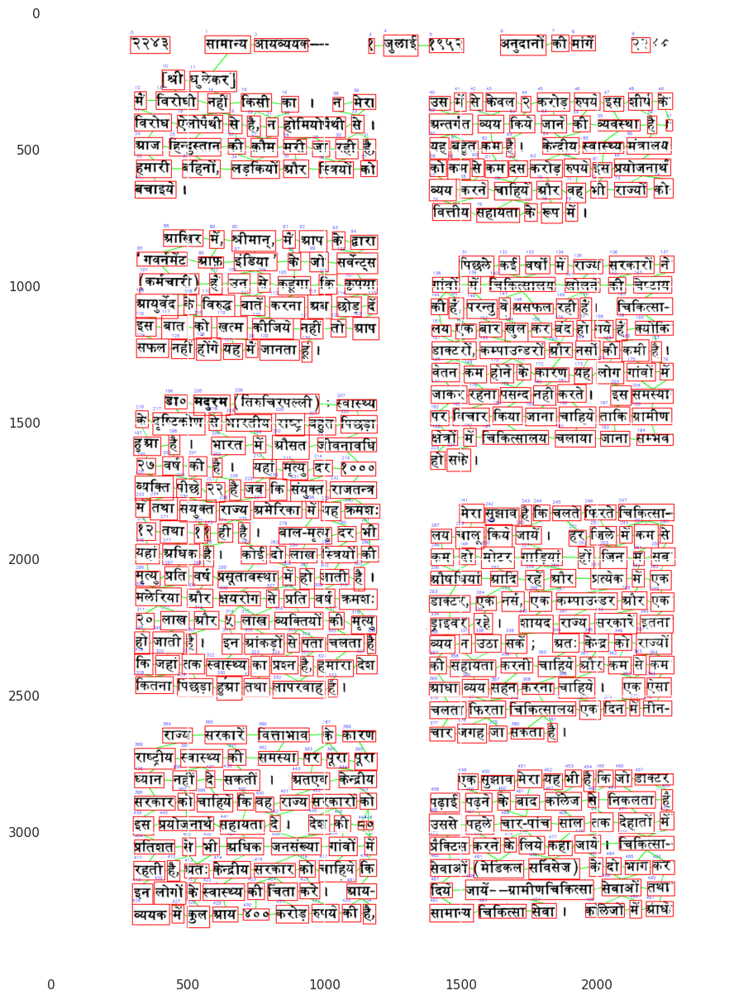

In [231]:
visualize_bboxes(make_connections(img, add_connections(df_with_distances, thr)))

### Image - 232

In [265]:
target = 232
document_img_path = 'SMAI - AQ2/images/{}.jpg'.format(target)
document_csv_path = 'SMAI - AQ2/CSV/TLBR_{}.csv'.format(target)
df = pd.read_csv(document_csv_path)
df.head()

,Unnamed: 0,Top-Left,Bottom-Right,Id
0,0,"[75, 68]","[259, 144]",0
1,1,"[46, 144]","[614, 352]",1
2,2,"[694, 215]","[713, 243]",2
3,3,"[778, 185]","[848, 284]",3
4,4,"[889, 157]","[1170, 311]",4


In [266]:
img = cv2.imread(document_img_path)

In [201]:
df_with_distances = add_distances(add_columns(df))

/tmp/ipykernel_2264/2425874049.py:23: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '255.99414055794324' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  data_copy.at[i, 'horizontal'] = horizontal
/tmp/ipykernel_2264/2425874049.py:19: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '123.03657992645927' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  data_copy.at[i, 'vertical'] = vertical


#### Bandwidth = 0.001

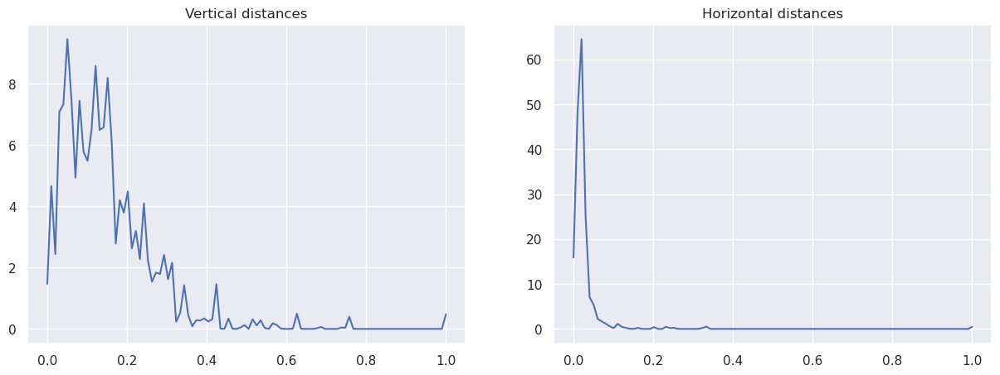

In [202]:
thr = get_threshold(df_with_distances, bandwidth=0.001)

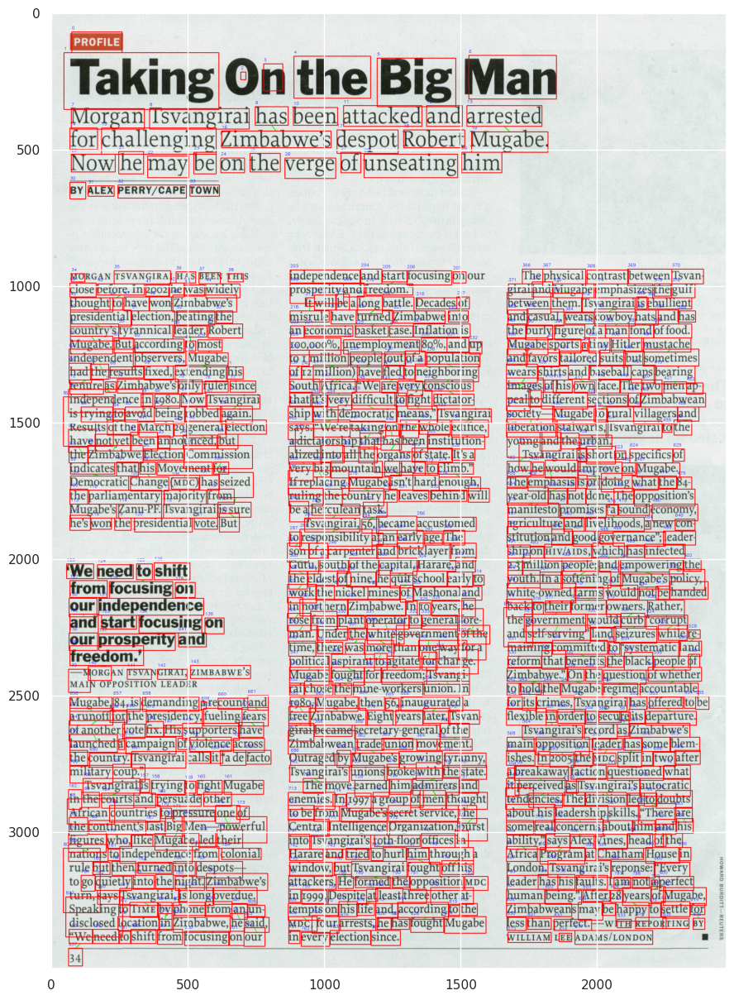

In [203]:
visualize_bboxes(make_connections(img, add_connections(df_with_distances, thr)))

#### Bandwidth = 0.01

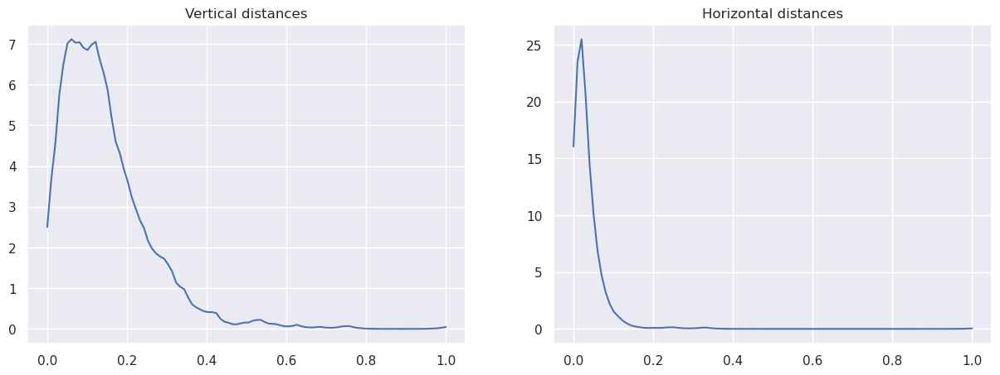

In [204]:
thr = get_threshold(df_with_distances, bandwidth=0.01)

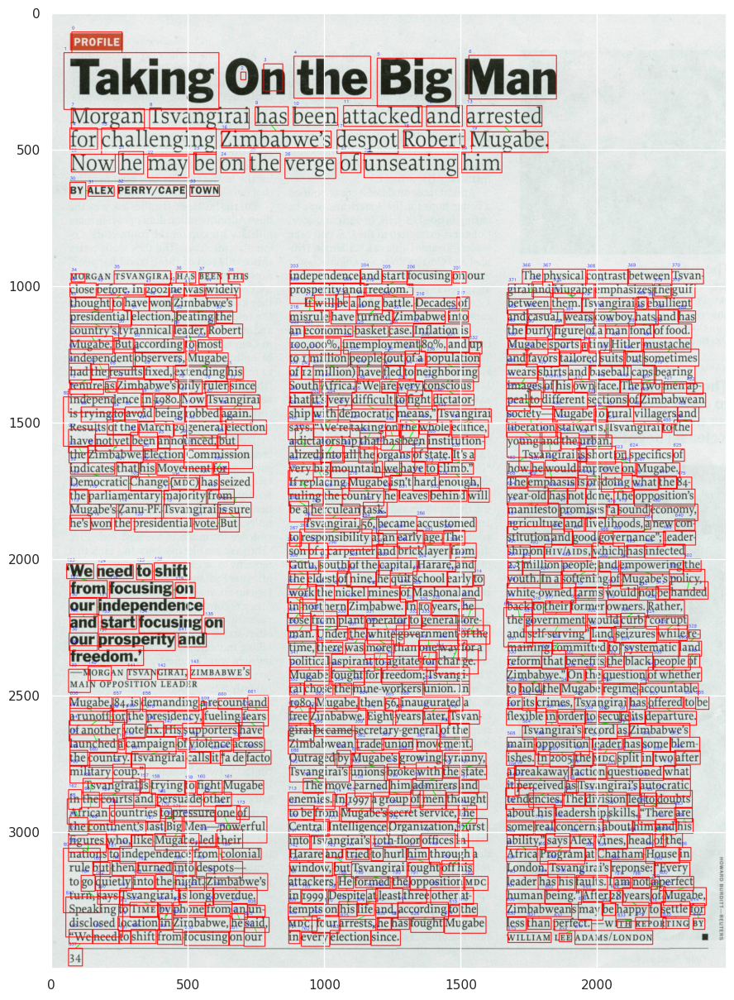

In [205]:
visualize_bboxes(make_connections(img, add_connections(df_with_distances, thr)))

#### Bandwidth = 0.1

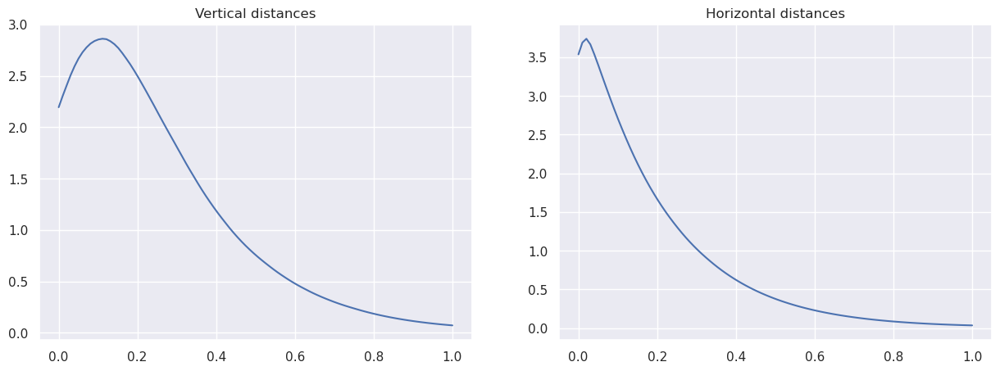

In [206]:
thr = get_threshold(df_with_distances, bandwidth=0.1)

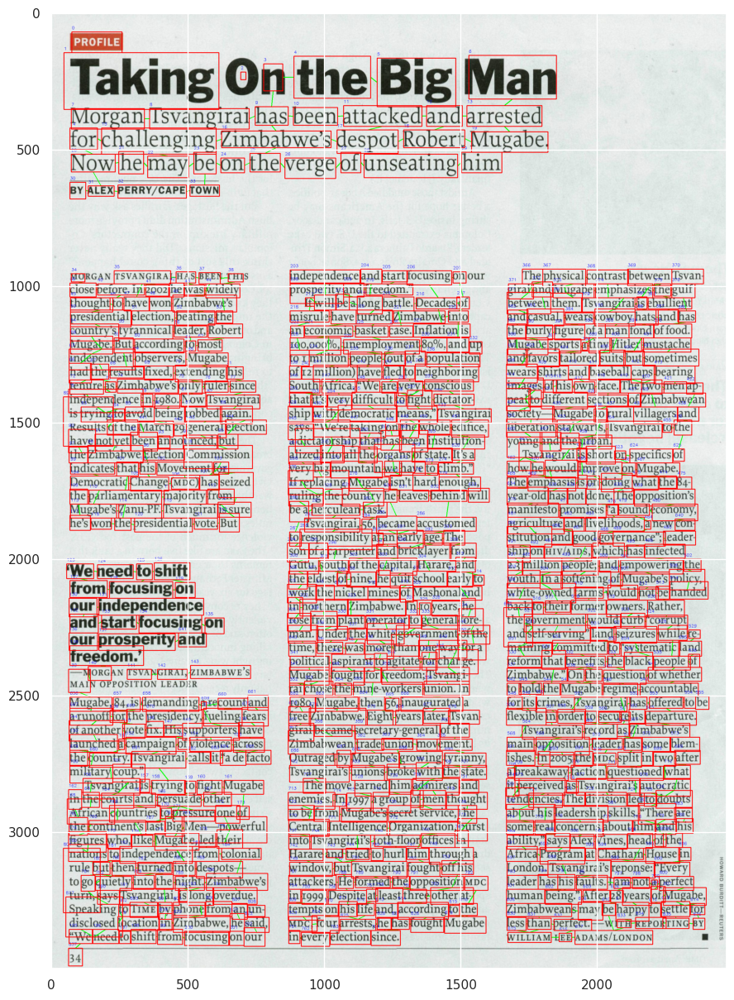

In [207]:
visualize_bboxes(make_connections(img, add_connections(df_with_distances, thr)))

#### Bandwidth = 0.5

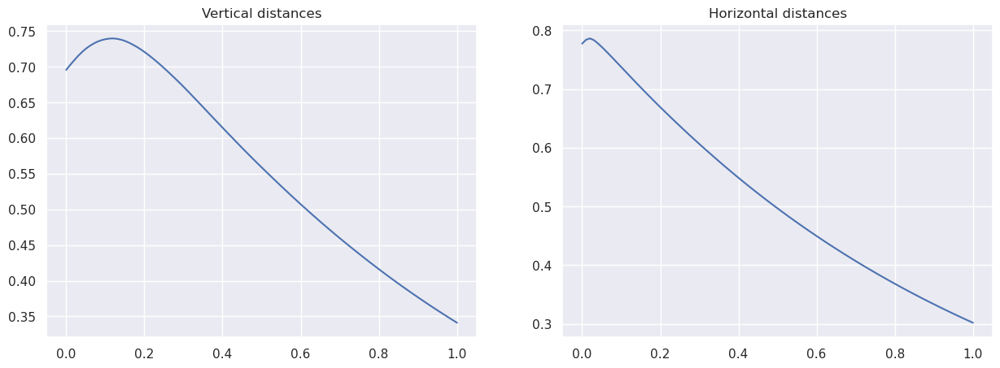

In [208]:
thr = get_threshold(df_with_distances, bandwidth=0.5)

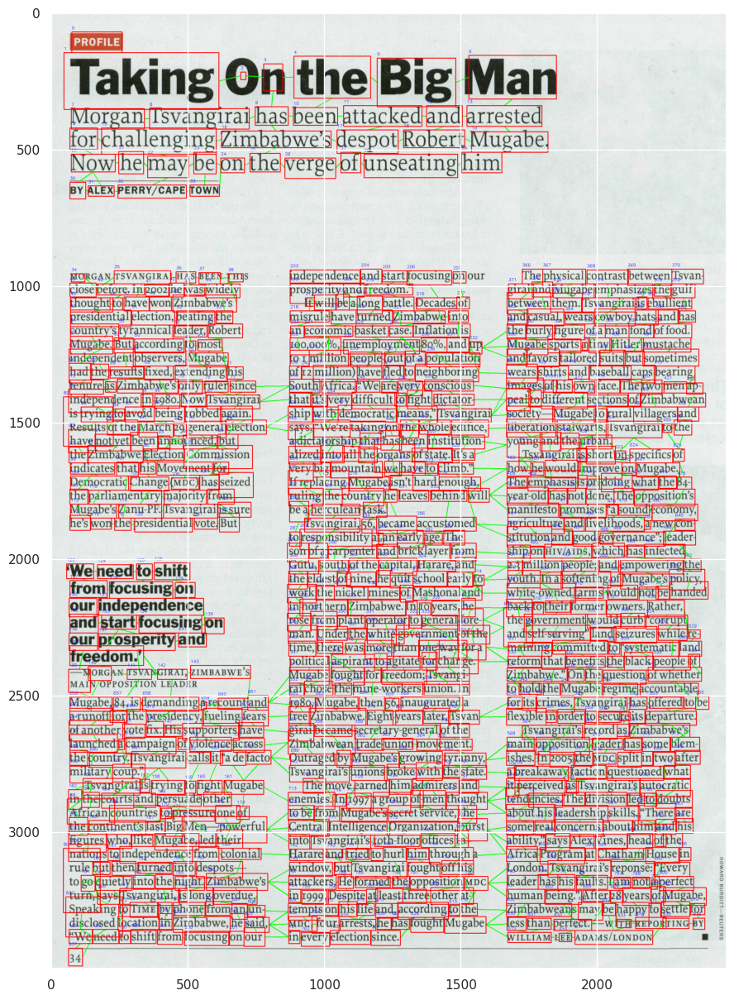

In [209]:
visualize_bboxes(make_connections(img, add_connections(df_with_distances, thr)))

### Image - 159

In [267]:
target = 159
document_img_path = 'SMAI - AQ2/images/{}.jpg'.format(target)
document_csv_path = 'SMAI - AQ2/CSV/TLBR_{}.csv'.format(target)
df = pd.read_csv(document_csv_path)
df.head()

,Unnamed: 0,Top-Left,Bottom-Right,Id
0,0,"[365, 291]","[783, 362]",0
1,1,"[802, 284]","[858, 342]",1
2,2,"[873, 291]","[931, 345]",2
3,3,"[1972, 280]","[2062, 335]",3
4,4,"[363, 455]","[464, 520]",4


In [268]:
img = cv2.imread(document_img_path)

In [269]:
df_with_distances = add_distances(add_columns(df))

/tmp/ipykernel_2264/2425874049.py:19: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '261.03064954139006' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  data_copy.at[i, 'vertical'] = vertical
/tmp/ipykernel_2264/2425874049.py:23: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '23.30772404161333' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  data_copy.at[i, 'horizontal'] = horizontal


#### Bandwidth = 0.001

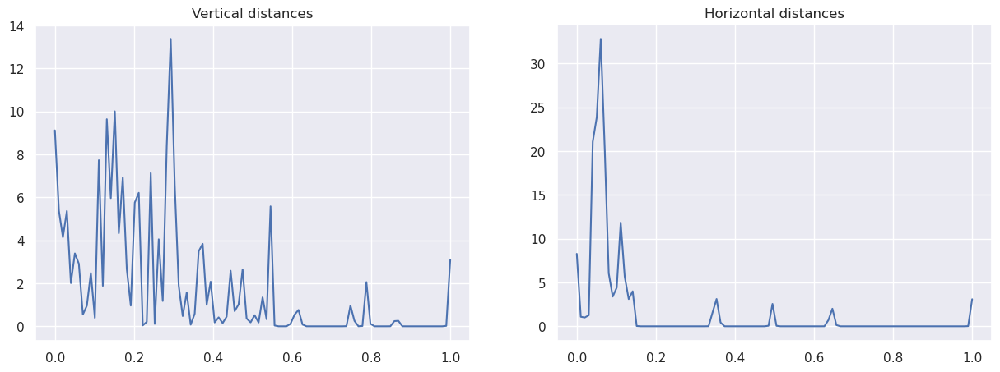

In [270]:
thr = get_threshold(df_with_distances, bandwidth=0.001)

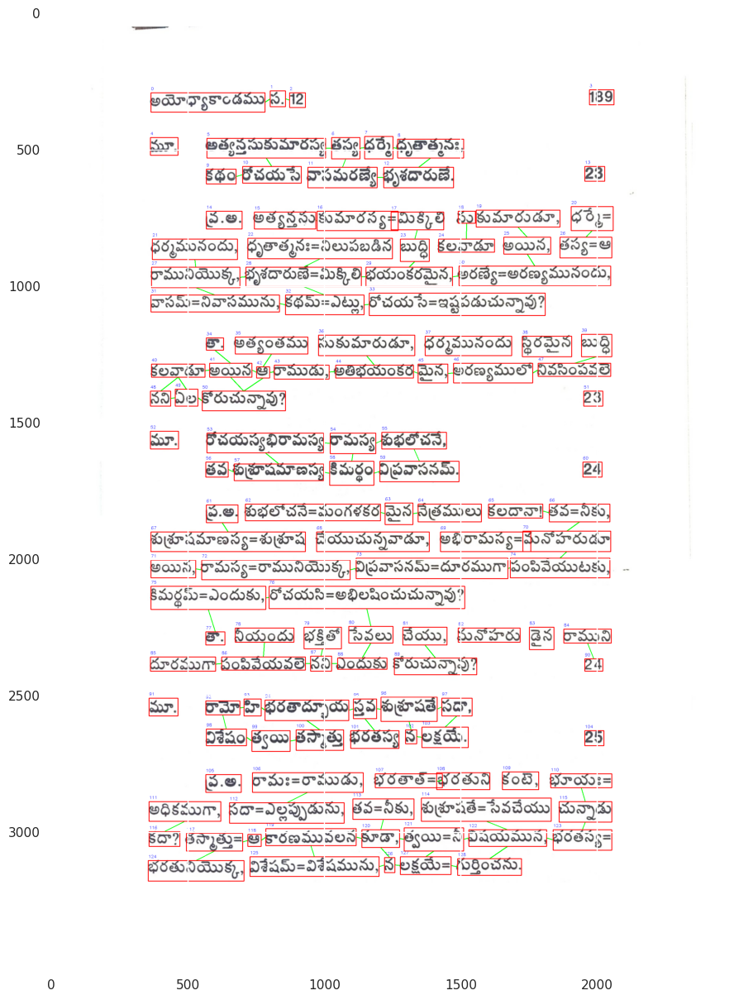

In [271]:
visualize_bboxes(make_connections(img, add_connections(df_with_distances, thr)))

#### Bandwidth = 0.01

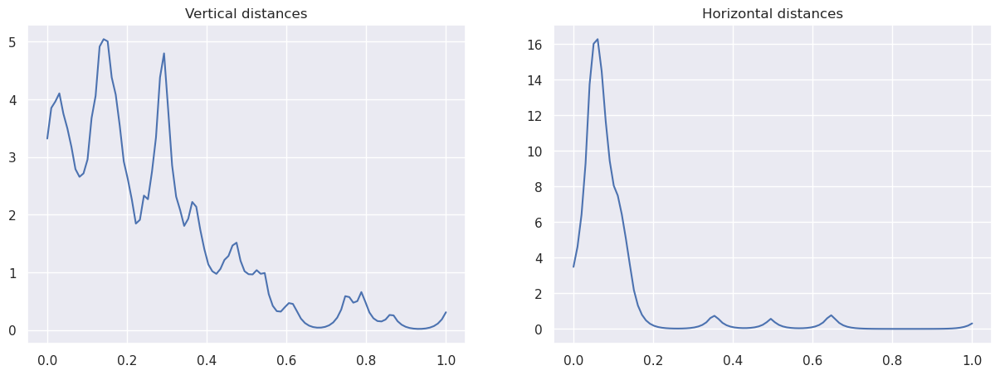

In [272]:
thr = get_threshold(df_with_distances, bandwidth=0.01)

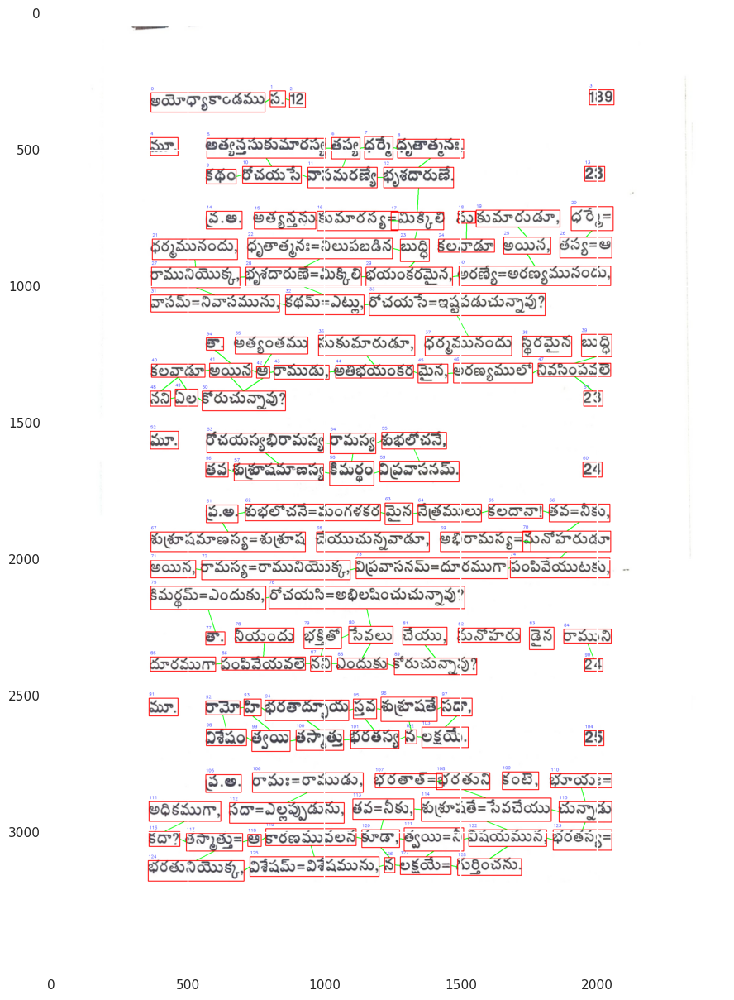

In [273]:
visualize_bboxes(make_connections(img, add_connections(df_with_distances, thr)))

#### Bandwidth = 0.1

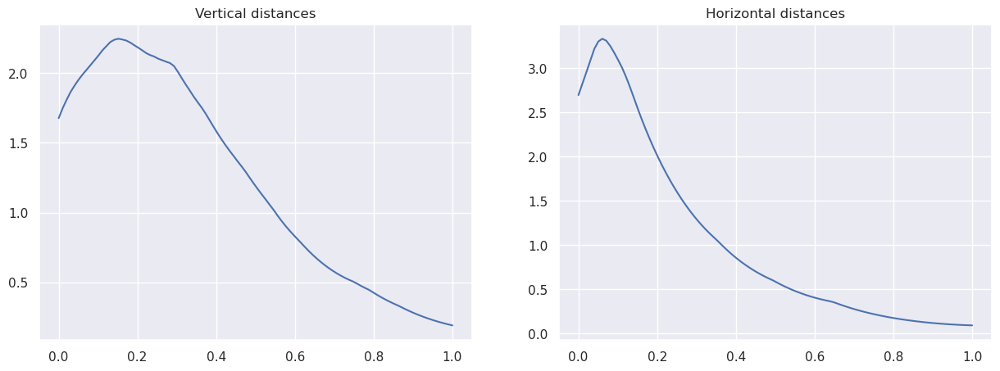

In [274]:
thr = get_threshold(df_with_distances, bandwidth=0.1)

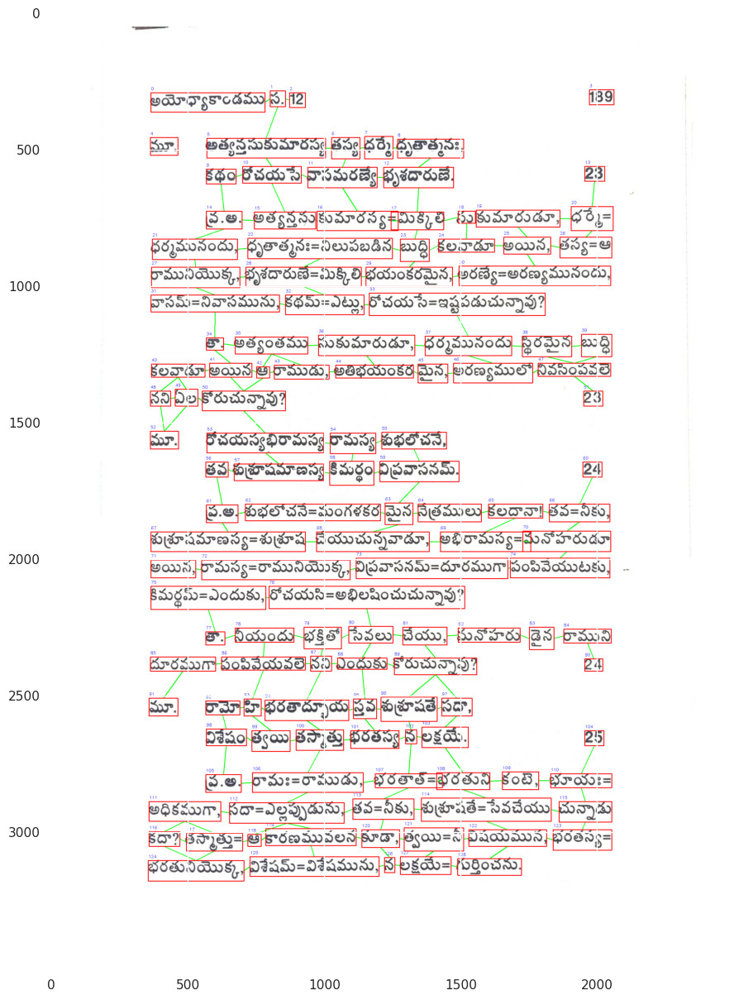

In [275]:
visualize_bboxes(make_connections(img, add_connections(df_with_distances, thr)))

#### Bandwidth = 0.5

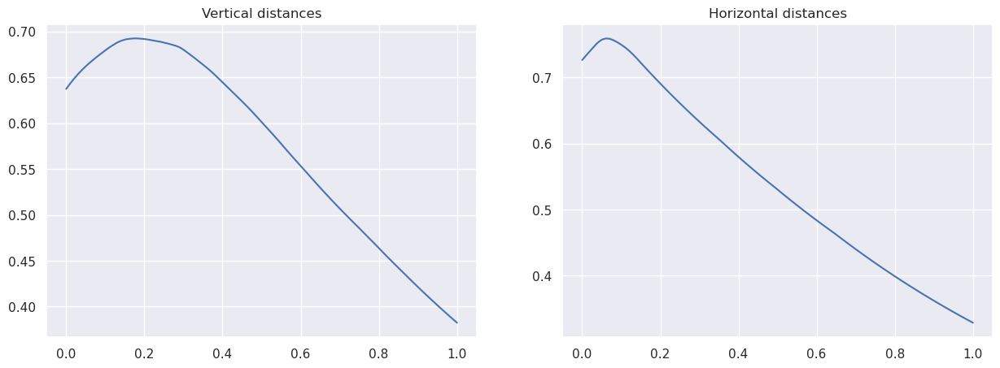

In [276]:
thr = get_threshold(df_with_distances, bandwidth=0.5)

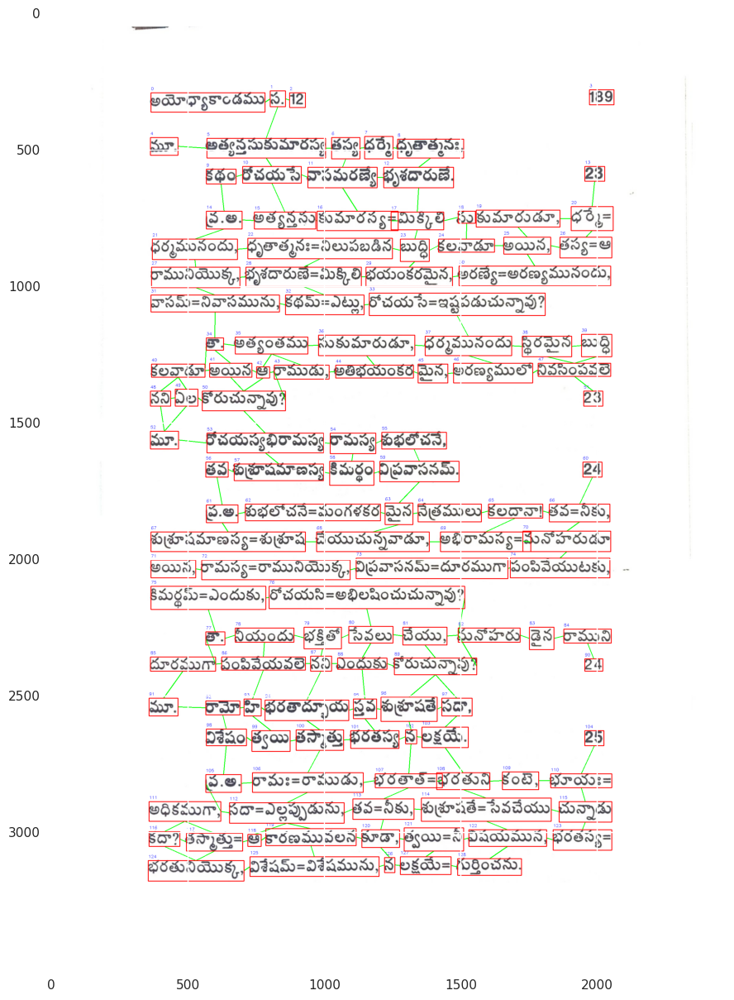

In [277]:
visualize_bboxes(make_connections(img, add_connections(df_with_distances, thr)))

## Comparison of images with respect to Hierarchical Clustering

Comparing results for - 29, 68, 145, 201, 232, 250

The hierarchical clustering algorithm is the same as used in assignment 4-2.

In [278]:
from scipy.cluster.hierarchy import linkage

def thresh_custom_distance(row1, row2):
    top1, bottom1, left1, right1 = (row1[0], row1[1]), (row1[2], row1[3]), (row1[4], row1[5]), (row1[6], row1[7])
    top2, bottom2, left2, right2 = (row2[0], row2[1]), (row2[2], row2[3]), (row2[4], row2[5]), (row2[6], row2[7])

    euclidean = lambda x1, x2: np.sqrt((x1[0] - x2[0]) ** 2 + (x1[1] - x2[1]) ** 2)
    return min(euclidean(top1, bottom2), euclidean(bottom1, top2), euclidean(left1, right2), euclidean(right1, left2))

def get_threshold_distance(frame):
    cols = ['Top', 'Bottom', 'Left', 'Right']
    data = frame[cols].copy()
    data = [[row[cols[0]][0], row[cols[0]][1], row[cols[1]][0], row[cols[1]][1],
                 row[cols[2]][0], row[cols[2]][1], row[cols[3]][0], row[cols[3]][1]] for index, row in data.iterrows()]
    data = np.array(data)

    # Finding vertical distance threshold using elbow method
    linkage_matrix = linkage(data, method='single', metric=thresh_custom_distance)
    min_clusts = 8
    max_clusts = 25
    # Find difference between consecutive distances
    diff = np.diff(linkage_matrix[:, 2], 2)
    optimal_clusters = 8
    max_gap = 0
    for i in range(len(diff)-min_clusts, len(diff) - max_clusts, -1):
        if diff[i] > max_gap:
            max_gap = diff[i]
            optimal_clusters = len(diff) - i

    return linkage_matrix[len(diff) - optimal_clusters, 2]

In [300]:
def compare_results(img, df, bandwidth=None):
    df_ = df.copy()
    df_with_distances = add_distances(df_)
    thr_new = get_threshold(df_with_distances, bandwidth=bandwidth)
    img_with_connections = make_connections(img, add_connections(df_with_distances, thr_new))
    thr_old = get_threshold_distance(df_)
    thr_old = (thr_old, thr_old)
    img_with_connections_old = make_connections(img, add_connections(df, thr_old))
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 15))
    ax1.imshow(img_with_connections)
    ax1.set_title('KDE')
    ax2.imshow(img_with_connections_old)
    ax2.set_title('Hierarchical Clustering')
    plt.show()

### Image - 29

In [301]:
target = 29
document_img_path = 'SMAI - AQ2/images/{}.jpg'.format(target)
document_csv_path = 'SMAI - AQ2/CSV/TLBR_{}.csv'.format(target)
df = pd.read_csv(document_csv_path)
df = add_columns(df)

In [302]:
img = cv2.imread(document_img_path)

/tmp/ipykernel_2264/2425874049.py:19: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '328.10059433045836' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  data_copy.at[i, 'vertical'] = vertical
/tmp/ipykernel_2264/2425874049.py:23: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '193.12690128513947' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  data_copy.at[i, 'horizontal'] = horizontal


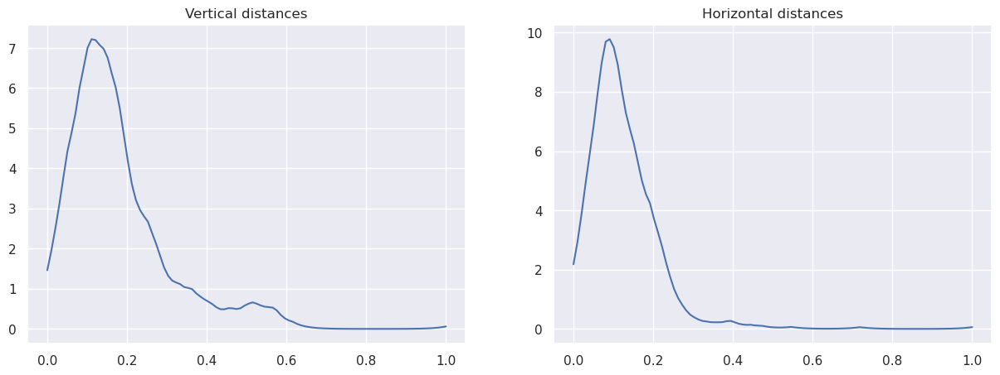

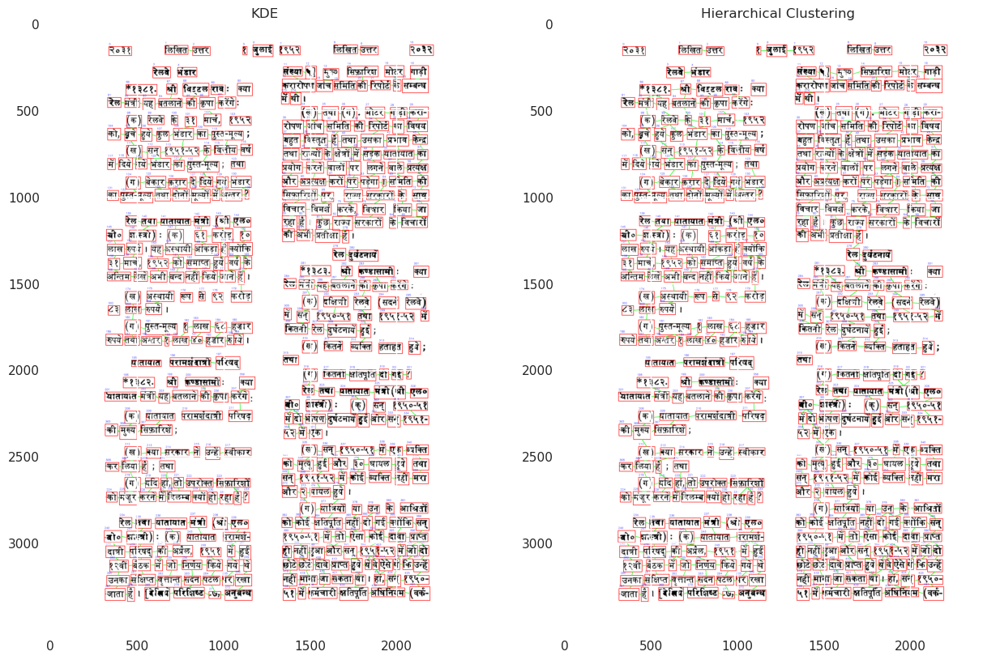

In [304]:
compare_results(img, df, bandwidth=0.015)

### Image - 68

In [305]:
target = 68
document_img_path = 'SMAI - AQ2/images/{}.jpg'.format(target)
document_csv_path = 'SMAI - AQ2/CSV/TLBR_{}.csv'.format(target)
df = pd.read_csv(document_csv_path)
df = add_columns(df)

In [306]:
img = cv2.imread(document_img_path)

/tmp/ipykernel_2264/2425874049.py:19: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '290.68883707497264' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  data_copy.at[i, 'vertical'] = vertical
/tmp/ipykernel_2264/2425874049.py:23: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '128.0087887607722' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  data_copy.at[i, 'horizontal'] = horizontal


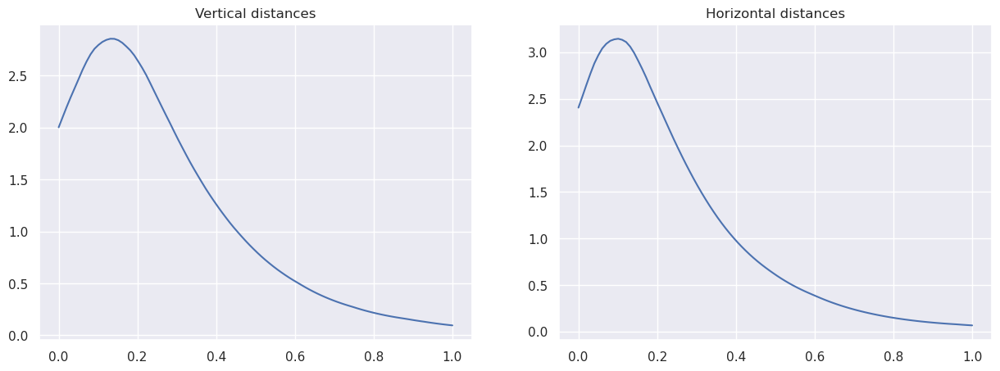

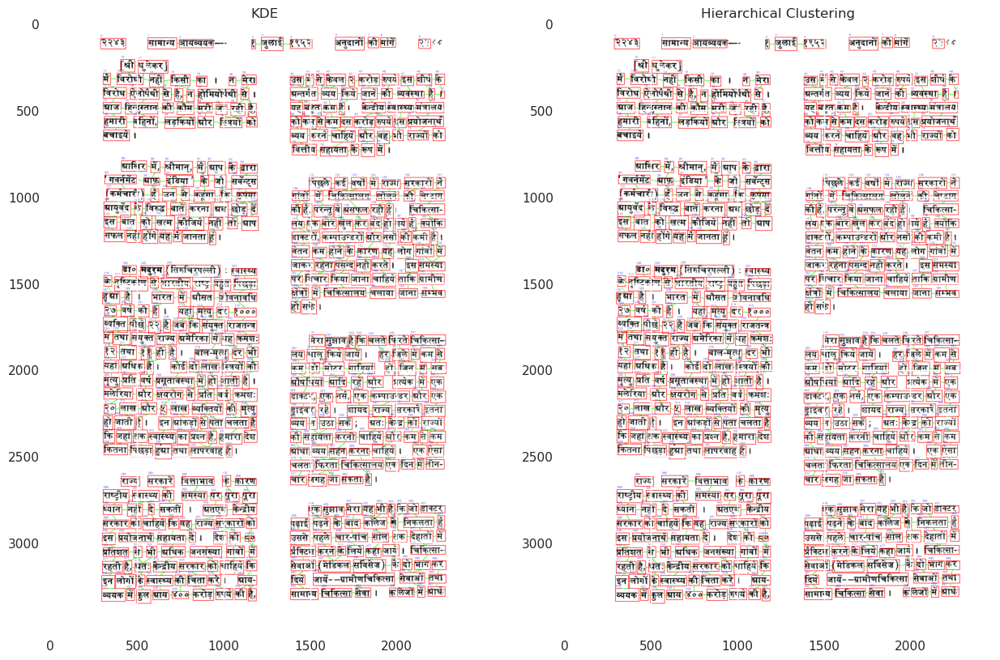

In [307]:
compare_results(img, df, bandwidth=0.1)

### Image - 145

In [308]:
target = 145
document_img_path = 'SMAI - AQ2/images/{}.jpg'.format(target)
document_csv_path = 'SMAI - AQ2/CSV/TLBR_{}.csv'.format(target)
df = pd.read_csv(document_csv_path)
df = add_columns(df)

In [309]:
img = cv2.imread(document_img_path)

/tmp/ipykernel_2264/2425874049.py:19: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '364.17200606306903' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  data_copy.at[i, 'vertical'] = vertical
/tmp/ipykernel_2264/2425874049.py:23: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '39.02883549377306' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  data_copy.at[i, 'horizontal'] = horizontal


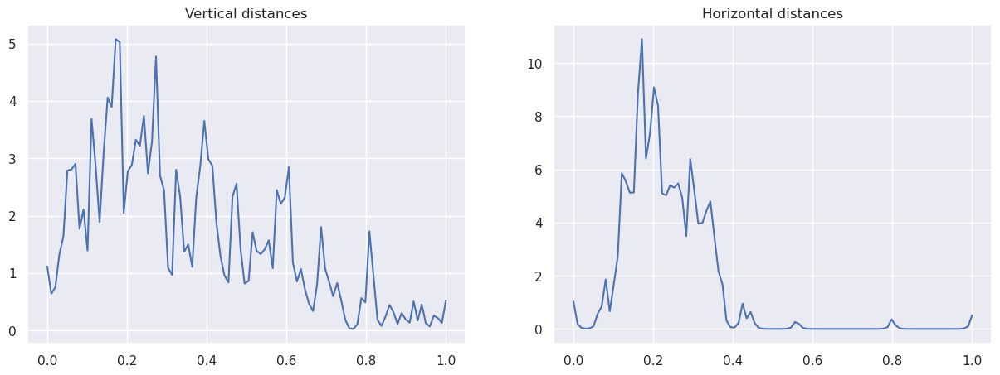

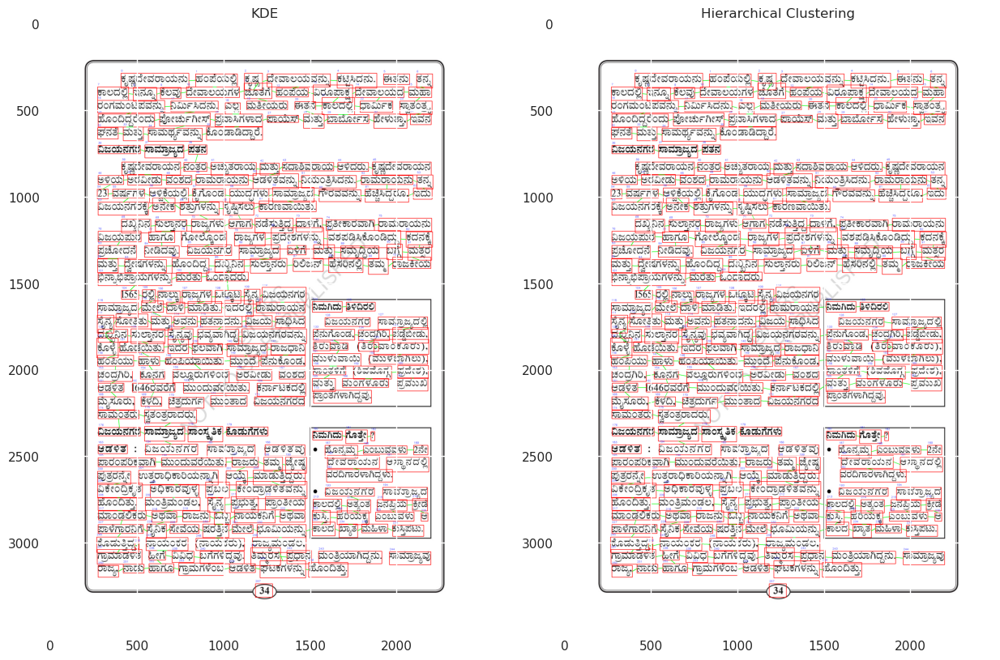

In [314]:
compare_results(img, df, bandwidth=0.003)

### Image - 201

In [318]:
target = 201
document_img_path = 'SMAI - AQ2/images/{}.jpg'.format(target)
document_csv_path = 'SMAI - AQ2/CSV/TLBR_{}.csv'.format(target)
df = pd.read_csv(document_csv_path)
df = add_columns(df)

In [319]:
img = cv2.imread(document_img_path)

/tmp/ipykernel_2264/2425874049.py:19: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '167.45521789421792' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  data_copy.at[i, 'vertical'] = vertical
/tmp/ipykernel_2264/2425874049.py:23: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '302.0413878924542' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  data_copy.at[i, 'horizontal'] = horizontal


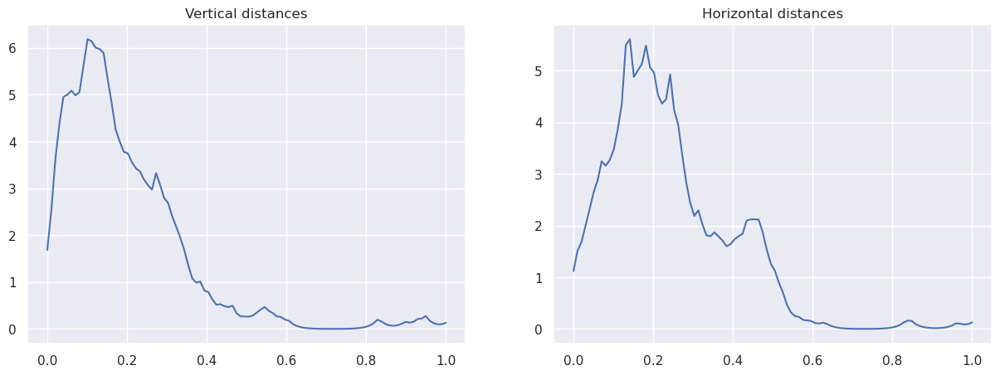

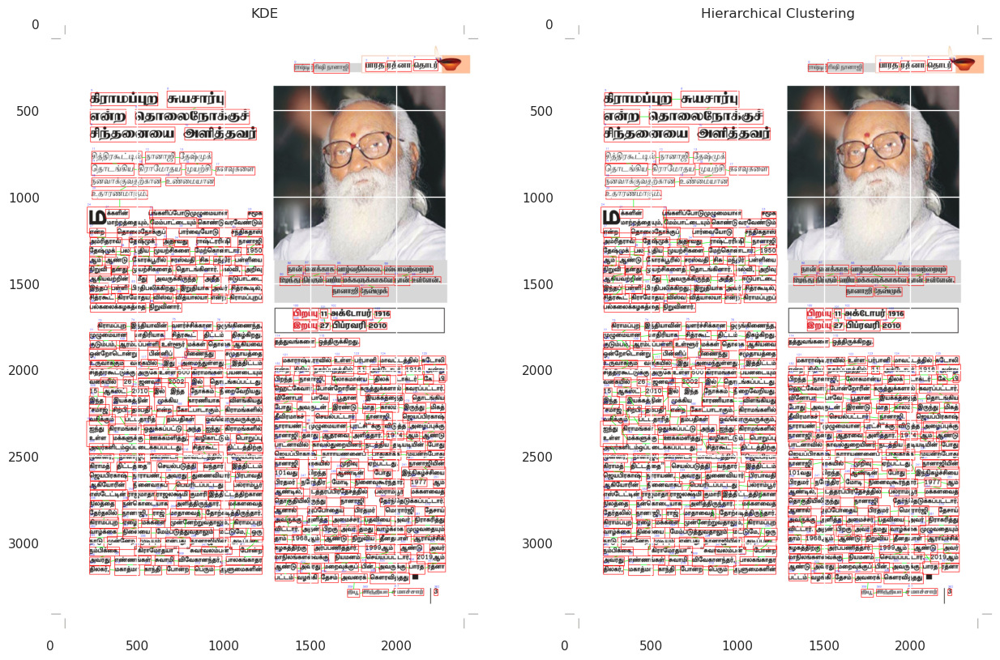

In [323]:
compare_results(img, df, bandwidth=0.01)

### Image - 232

In [324]:
target = 232
document_img_path = 'SMAI - AQ2/images/{}.jpg'.format(target)
document_csv_path = 'SMAI - AQ2/CSV/TLBR_{}.csv'.format(target)
df = pd.read_csv(document_csv_path)
df = add_columns(df)

In [325]:
img = cv2.imread(document_img_path)

/tmp/ipykernel_2264/2425874049.py:23: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '255.99414055794324' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  data_copy.at[i, 'horizontal'] = horizontal
/tmp/ipykernel_2264/2425874049.py:19: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '123.03657992645927' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  data_copy.at[i, 'vertical'] = vertical


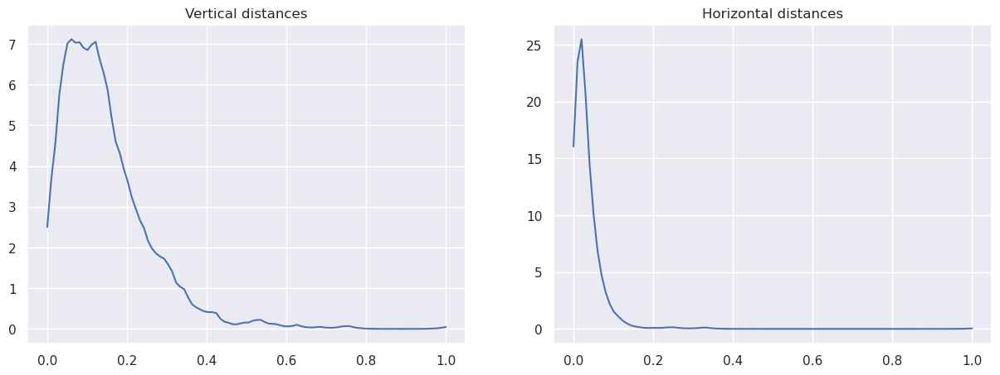

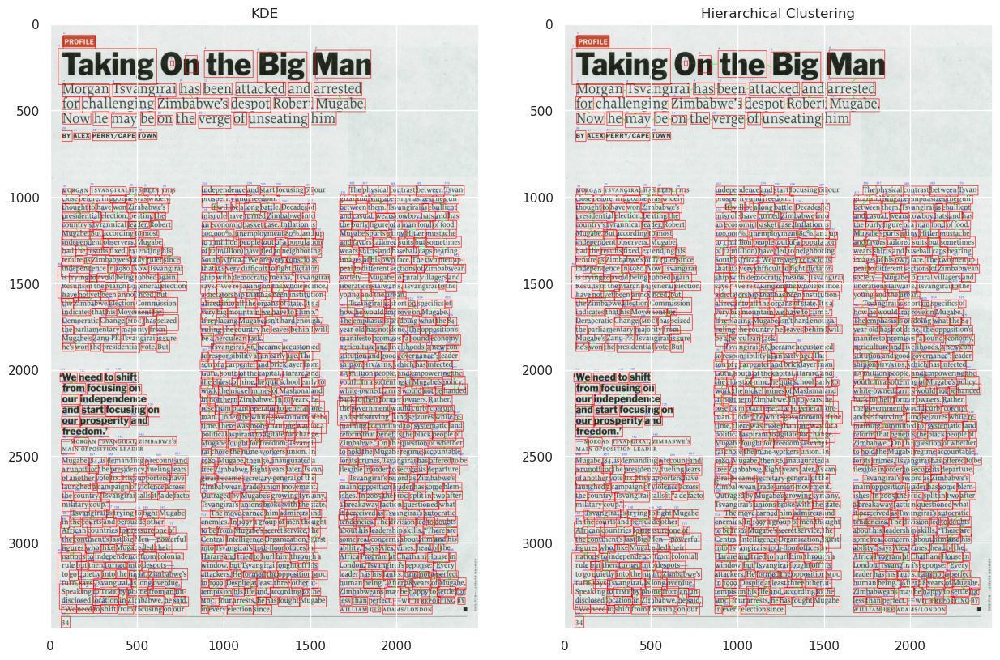

In [326]:
compare_results(img, df, bandwidth=0.01)

### Image - 250

In [327]:
target = 250
document_img_path = 'SMAI - AQ2/images/{}.jpg'.format(target)
document_csv_path = 'SMAI - AQ2/CSV/TLBR_{}.csv'.format(target)
df = pd.read_csv(document_csv_path)
df = add_columns(df)

In [328]:
img = cv2.imread(document_img_path)

/tmp/ipykernel_2264/2425874049.py:19: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '227.22950952726188' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  data_copy.at[i, 'vertical'] = vertical
/tmp/ipykernel_2264/2425874049.py:23: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '17.356554957709783' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  data_copy.at[i, 'horizontal'] = horizontal


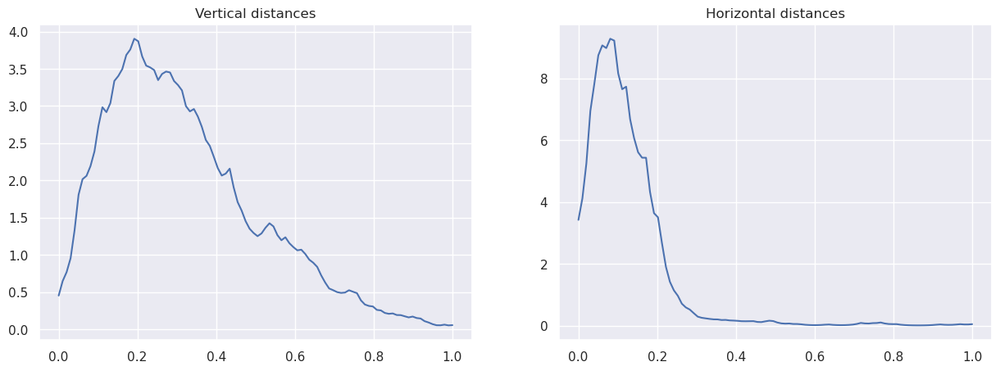

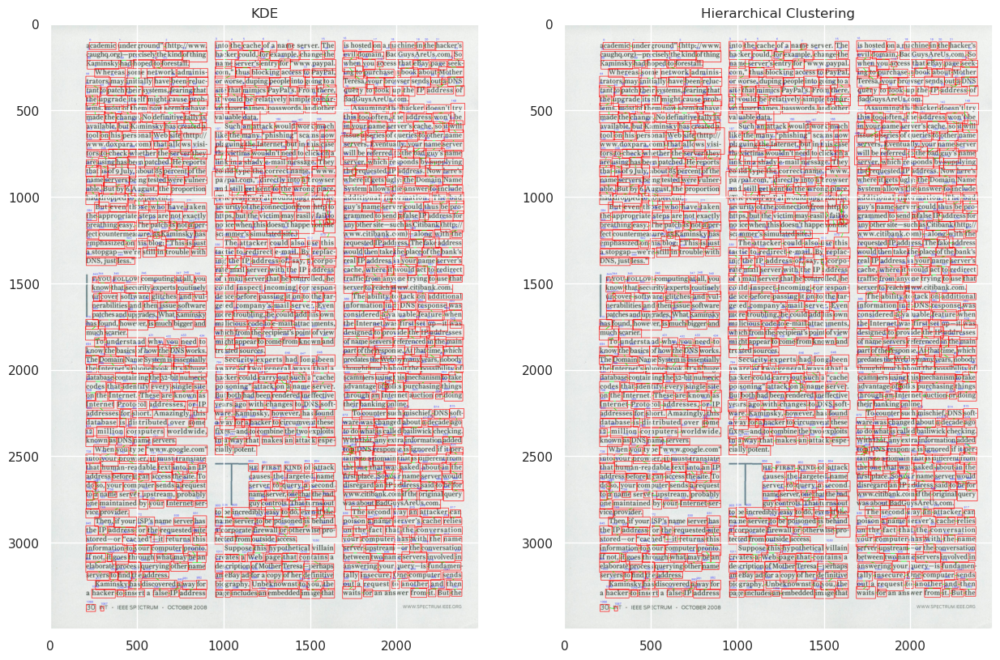

In [329]:
compare_results(img, df, bandwidth=0.01)